
# Preprocessing - Doublet Detection - scMultiome FVF Mouse Crypts Multiome GEX & ATAC

Michael Sterr

2023-11-29 20:10:18    


# Setup


In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

/tmp/ipykernel_981293/495279268.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
import os

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
from matplotlib.pyplot import rc_context
import seaborn as sb

# Analysis
import muon as mu
import scanpy as sc
import scanpy.external as sce
import scrublet as scr
import doubletdetection
import scvi

Global seed set to 0


In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_versions()

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                 9.4.0
absl                NA
asttokens           NA
attr                22.2.0
backcall            0.2.0
certifi             2022.12.07
cffi                1.15.1
charset_normalizer  3.1.0
chex                0.1.6
comm                0.1.2
contextlib2         NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.6
decorator           5.1.1
defusedxml          0.7.1
docrep              0.3.2
doubletdetection    4.2
etils               1.0.0
executing           1.2.0
flax                0.6.6
fsspec              2023.3.0
h5py                3.8.0
idna                3.4
igraph              0.10.8
importlib_resources NA
ipykernel           6.21.2
ipython_genutils    0.2.0
ipywidgets          7.7.1
jax                 0.4.5
jaxlib              0.4.4
jedi                0.18.2
joblib              1.2.0
kiwisolver          1.4.4
leidenalg           0.10.1
lightning_fabric    

In [4]:
# Color maps
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())

In [5]:
# Plot settings
%matplotlib inline

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_Mouse_Intestine_NVF-FVF_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

# Setup R

In [6]:
#R
import os
os.environ['R_HOME'] = '/home/michi/Software/venvs/scverse_2023/lib/R' #path to your R installation

import rpy2
import rpy2.robjects as ro
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

## R settings

### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [7]:
%%R

.libPaths()

[1] "/home/michi/Software/venvs/scverse_2023/lib/R/library"


In [8]:
%%R

# # Parallelization
# library("BiocParallel.FutureParam")
# register(FutureParam())
# plan(multicore, workers=64)
# options(future.globals.maxSize = 128 * 1024 ^ 3) # for 50 Gb RAM

sessionInfo()

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Ubuntu 20.04.6 LTS

Matrix products: default
BLAS/LAPACK: /home/michi/Software/venvs/scverse_2023_test/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] tools     stats     graphics  grDevices utils     datasets  methods  
[8] base     

loaded via a namespace (and not attached):
[1] compiler_4.2.2


# Functions

In [9]:
def threshold(
    clf,
    show=False,
    save=None,
    log10=True,
    log_p_grid=None,
    voter_grid=None,
    v_step=2,
    p_step=5,
):
    """Produce a plot showing number of cells called doublet across
       various thresholds
    Args:
        clf (BoostClassifier object): Fitted classifier
        show (bool, optional): If True, runs plt.show()
        save (str, optional): If provided, the figure is saved to this
            filepath.
        log10 (bool, optional): Use log 10 if true, natural log if false.
        log_p_grid (ndarray, optional): log p-value thresholds to use.
            Defaults to np.arange(-100, -1). log base decided by log10
        voter_grid (ndarray, optional): Voting thresholds to use. Defaults to
            np.arange(0.3, 1.0, 0.05).
        p_step (int, optional): number of xlabels to skip in plot
        v_step (int, optional): number of ylabels to skip in plot
    Returns:
        matplotlib figure
    """
    import warnings
    # Ignore numpy complaining about np.nan comparisons
    with np.errstate(invalid="ignore"):
        all_log_p_values_ = np.copy(clf.all_log_p_values_)
        if log10:
            all_log_p_values_ /= np.log(10)
        if log_p_grid is None:
            log_p_grid = np.arange(-100, -1)
        if voter_grid is None:
            voter_grid = np.arange(0.3, 1.0, 0.05)
        doubs_per_t = np.zeros((len(voter_grid), len(log_p_grid)))
        for i in range(len(voter_grid)):
            for j in range(len(log_p_grid)):
                voting_average = np.mean(
                    np.ma.masked_invalid(all_log_p_values_) <= log_p_grid[j], axis=0
                )
                labels = np.ma.filled((voting_average >= voter_grid[i]).astype(float), np.nan)
                doubs_per_t[i, j] = np.nansum(labels)

    # Ignore warning for convergence plot
    with warnings.catch_warnings():
        warnings.filterwarnings(action="ignore", module="matplotlib", message="^tight_layout")

        f, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=150)
        cax = ax.imshow(doubs_per_t, cmap="turbo", aspect="auto")
        ax.set_xticks(np.arange(len(log_p_grid))[::p_step])
        ax.set_xticklabels(np.around(log_p_grid, 1)[::p_step], rotation="vertical")
        ax.set_yticks(np.arange(len(voter_grid))[::v_step])
        ax.set_yticklabels(np.around(voter_grid, 2)[::v_step])
        cbar = f.colorbar(cax)
        cbar.set_label("Predicted Doublets")
        if log10 is True:
            ax.set_xlabel("Log10 p-value")
        else:
            ax.set_xlabel("Log p-value")
        ax.set_ylabel("Voting Threshold")
        ax.set_title("Threshold Diagnostics")

    if show is True:
        plt.show()
    if save:
        f.savefig(save, format="pdf", bbox_inches="tight")

    return f



####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################


def run_scDblFinder(adata, force_reload=False, layer=None, n_core=64, max_memory_gb=128):
    '''
    adata: adata object to normalize
    layer: layer to use for normalization. Default = None -> use .X
    force_reload: Force transfer of count data to R
    '''
    
    import rpy2
    import rpy2.robjects as ro
    import gc

       
    print('Finding doublets with scDblFinder:')
    # load packages
    ro.globalenv['n_core'] = n_core
    ro.globalenv['max_memory'] = max_memory_gb #/n_core
    ro.r('''
    print(paste0("Cores: ", n_core))
    print(paste0("Memory: ", max_memory))
    ''')
    ro.r('''

    # Analysis
    library(Seurat)
    library(sctransform)
    library(scDblFinder)
    library(SingleCellExperiment)
    library(scater)
    library(pastecs)

    # Parallelization
    library(BiocParallel)
    register(MulticoreParam(n_core, progressbar = TRUE))

    library(future)
    plan(multicore, workers = n_core)
    options(future.globals.maxSize = max_memory * 1024^3) # for 50 Gb RAM
    plan()

    library(doParallel)
    registerDoParallel(n_core)
    ''')
    # transfer data
    print('\tTransfer data...')
    
    # check if data is in R workspace
    if ro.r('''exists('data_mat')''')[0] == 1:
        # check if data has same shape
        if ro.globalenv['data_mat'].shape == adata.X.T.shape:
            load_data = False
            print('\t\tFound data matrix of same shape. Skipping data transfer...')
        else:
            load_data = True
    else:
        load_data = True
        
    if force_reload:
        load_data = True
    
    if load_data:
        if layer is None:
            ro.globalenv['data_mat'] = adata.X.T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        else:
            print('\tUsing layer \'', layer,'\'...')
            ro.globalenv['data_mat'] = adata.layers[layer].T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        
        ro.r('''
        rownames(data_mat) <- var_names
        colnames(data_mat) <- obs_names
        ''') 
    # standart preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with standard normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- NormalizeData(seurat, verbose = FALSE)
    seurat <- FindVariableFeatures(seurat, selection.method = "vst", nfeatures = 5000, verbose = FALSE)
    seurat <- ScaleData(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    
    #Conversion to SingleCellExperiment
    sce <- as.SingleCellExperiment(seurat)
    ''')
    ## run scDblFinder
    print('\t\tRunning scDblFinder...')
    ro.r('''
    #scDblFinder
    colData(sce)$scoresDoubletDensity <- computeDoubletDensity(sce)
    sce <- scDblFinder(sce, clusters = FALSE) #, dbr=0.1)
    ''')
    
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- colData(sce)[,c("scDblFinder.class", "scDblFinder.score")]    
    ''')
    
    # sct preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with SCT normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- SCTransform(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    
    #Conversion to SingleCellExperiment
    sce <- as.SingleCellExperiment(seurat)
    ''')
    ## run scDblFinder
    print('\t\tRunning scDblFinder...')
    ro.r('''
    #scDblFinder
    colData(sce)$scoresDoubletDensity <- computeDoubletDensity(sce)
    sce <- scDblFinder(sce, clusters = FALSE) #, dbr=0.1)
    ''')
    
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- cbind(results, colData(sce)[,c("scDblFinder.class", "scDblFinder.score")])
    colnames(results) <- c("scDblFinder.class", "scDblFinder.score", "scDblFinder.class.sct", "scDblFinder.score.sct")
    ''')
    print('\t\tAdd results to anndata...')
    results = ro.globalenv['results']
    
    # check if results are already present in adata.obs and delete
    if 'scDblFinder.class' in adata.obs.columns:
        del adata.obs[["scDblFinder.class.sct", "scDblFinder.score.sct", "scDblFinder.class.sct", "scDblFinder.score.sct"]]
    
    adata.obs = pd.merge(adata.obs,results, left_index=True, right_index=True) #adata.obs[["scDblFinder.class.sct", "scDblFinder.score.sct"]] = results.copy()
    
    adata.obs.loc[:,'sdf_doublets'] = False
    adata.obs.loc[adata.obs.loc[:,'scDblFinder.class']=='doublet','sdf_doublets'] = True
    adata.obs.loc[adata.obs.loc[:,'scDblFinder.class.sct']=='doublet','sdf_doublets'] = True
    
    print('\n\n------------------------------------------------------------------------------------\n------------------------------------------------------------------------------------' )
    print('\nscDblFinder doublet rate:', adata.obs['sdf_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['sdf_doublets'].value_counts()[1],' cells)' )
    
    #return adata




####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################




def run_SCDS(adata, force_reload=False, layer=None, n_core=64, max_memory_gb=128):
    '''
    adata: adata object to normalize
    layer: layer to use for normalization. Default = None -> use .X
    force_reload: Force transfer of count data to R
    '''
    
    import rpy2
    import rpy2.robjects as ro
    import gc

       
    print('Finding doublets with scDblFinder:')
    # load packages
    ro.globalenv['n_core'] = n_core
    ro.globalenv['max_memory'] = max_memory_gb #/n_core
    ro.r('''
    print(paste0("Cores: ", n_core))
    print(paste0("Memory: ", max_memory))
    ''')
    ro.r('''

    # Analysis
    library(Seurat)
    library(sctransform)
    library(scds)
    library(SingleCellExperiment)
    library(scater)
    library(pastecs)

    # Parallelization
    library(BiocParallel)
    register(MulticoreParam(n_core, progressbar = TRUE))

    library(future)
    plan(multicore, workers = n_core)
    options(future.globals.maxSize = max_memory * 1024^3) # for 50 Gb RAM
    plan()

    library(doParallel)
    registerDoParallel(n_core)
    ''')
    # transfer data
    print('\tTransfer data...')
    
    # check if data is in R workspace
    if ro.r('''exists('data_mat')''')[0] == 1:
        # check if data has same shape
        if ro.globalenv['data_mat'].shape == adata.X.T.shape:
            load_data = False
            print('\t\tFound data matrix of same shape. Skipping data transfer...')
        else:
            load_data = True
    else:
        load_data = True
        
    if force_reload:
        load_data = True
    
    if load_data:
        if layer is None:
            ro.globalenv['data_mat'] = adata.X.T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        else:
            print('\tUsing layer \'', layer,'\'...')
            ro.globalenv['data_mat'] = adata.layers[layer].T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        
        ro.r('''
        rownames(data_mat) <- var_names
        colnames(data_mat) <- obs_names
        ''') 
    # standart preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with standard normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- NormalizeData(seurat, verbose = FALSE)
    seurat <- FindVariableFeatures(seurat, selection.method = "vst", nfeatures = 5000, verbose = FALSE)
    seurat <- ScaleData(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    
    #Conversion to SingleCellExperiment
    sce <- as.SingleCellExperiment(seurat)
    ''')
    ## run SCDS
    print('\t\tRunning SCDS...')
    ro.r('''
    # SCDS
    sce <- cxds(sce, retRes = TRUE)
    sce <- bcds(sce, retRes = TRUE, verb=TRUE)
    sce <- cxds_bcds_hybrid(sce)
    
    dens <- density(sce$hybrid_score)
    min_idx <- match(-1, extract(turnpoints(dens$y, calc.proba = TRUE)))
    cut_off <- dens$x[min_idx[length(min_idx)]]
    
    #print(ggplot(as.data.frame(colData(sce)), aes(x=hybrid_score)) + geom_density() + geom_vline(xintercept = cut_off, linetype=2))
    
    sce$hybrid_class <- "doublet"
    sce[,sce$hybrid_score < cut_off]$hybrid_class <- "singlet"
    ''')
    
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- colData(sce)[,c("hybrid_class", "hybrid_score")]    
    ''')
    
    # sct preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with SCT normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- SCTransform(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    
    #Conversion to SingleCellExperiment
    sce <- as.SingleCellExperiment(seurat)
    ''')
    ## run SCDS
    print('\t\tRunning SCDS...')
    ro.r('''
    # SCDS
    sce <- cxds(sce, retRes = TRUE)
    sce <- bcds(sce, retRes = TRUE, verb=TRUE)
    sce <- cxds_bcds_hybrid(sce)
    
    dens <- density(sce$hybrid_score)
    min_idx <- match(-1, extract(turnpoints(dens$y, calc.proba = TRUE)))
    cut_off <- dens$x[min_idx[length(min_idx)]]
    
    #print(ggplot(as.data.frame(colData(sce)), aes(x=hybrid_score)) + geom_density() + geom_vline(xintercept = cut_off, linetype=2))
    
    sce$hybrid_class <- "doublet"
    sce[,sce$hybrid_score < cut_off]$hybrid_class <- "singlet"
    ''')
    
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- cbind(results, colData(sce)[,c("hybrid_class", "hybrid_score")])
    colnames(results) <- c("hybrid_class", "hybrid_score", "hybrid_class_sct", "hybrid_score_sct")
    ''')
    print('\t\tAdd results to anndata...')
    results = ro.globalenv['results']
    
    # check if results are already present in adata.obs and delete
    if 'hybrid_class' in adata.obs.columns:
        del adata.obs[["hybrid_class", "hybrid_score", "hybrid_class_sct", "hybrid_score_sct"]]
    
    adata.obs = pd.merge(adata.obs,results, left_index=True, right_index=True) 
    
    adata.obs.loc[:,'scds_doublets'] = False
    adata.obs.loc[adata.obs.loc[:,'hybrid_class']=='doublet','scds_doublets'] = True
    adata.obs.loc[adata.obs.loc[:,'hybrid_class_sct']=='doublet','scds_doublets'] = True
    
    print('\n\n------------------------------------------------------------------------------------\n------------------------------------------------------------------------------------' )
    print('\nScds doublet rate:', adata.obs['scds_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['scds_doublets'].value_counts()[1],' cells)' )
    
#     return adata
 


##################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################




def run_DoubletFinder(adata, force_reload=False, layer=None, n_core=64, max_memory_gb=128):
    '''
    adata: adata object to normalize
    layer: layer to use for normalization. Default = None -> use .X
    force_reload: Force transfer of count data to R
    '''
    
    import rpy2
    import rpy2.robjects as ro
    import gc

       
    print('Finding doublets with scDblFinder:')
    # load packages
    ro.globalenv['n_core'] = n_core
    ro.globalenv['max_memory'] = max_memory_gb #/n_core
    ro.r('''
    print(paste0("Cores: ", n_core))
    print(paste0("Memory: ", max_memory))
    ''')
    ro.r('''

    # Analysis
    library(Seurat)
    library(sctransform)
    library(DoubletFinder)
    library(SingleCellExperiment)
    library(scater)
    library(pastecs)

    # Parallelization
    library(BiocParallel)
    register(MulticoreParam(n_core, progressbar = TRUE))

    library(future)
    plan(multicore, workers = n_core)
    options(future.globals.maxSize = max_memory * 1024^3) # for 50 Gb RAM
    plan()

    library(doParallel)
    registerDoParallel(n_core)
    
    # Adaption of original funtion to omit plot (https://github.com/chris-mcginnis-ucsf/DoubletFinder/blob/5dfd96b06365d7843adf3a72ffb6a30f42c74a01/R/find.pK.R)
    find.pK.noPlot <- function(sweep.stats) {

      ## Implementation for data without ground-truth doublet classifications 
      '%ni%' <- Negate('%in%')
      if ("AUC" %ni% colnames(sweep.stats) == TRUE) {
        ## Initialize data structure for results storage
        bc.mvn <- as.data.frame(matrix(0L, nrow=length(unique(sweep.stats$pK)), ncol=5))
        colnames(bc.mvn) <- c("ParamID","pK","MeanBC","VarBC","BCmetric")
        bc.mvn$pK <- unique(sweep.stats$pK)
        bc.mvn$ParamID <- 1:nrow(bc.mvn)

        ## Compute bimodality coefficient mean, variance, and BCmvn across pN-pK sweep results
        x <- 0
        for (i in unique(bc.mvn$pK)) {
          x <- x + 1
          ind <- which(sweep.stats$pK == i)
          bc.mvn$MeanBC[x] <- mean(sweep.stats[ind, "BCreal"])
          bc.mvn$VarBC[x] <- sd(sweep.stats[ind, "BCreal"])^2
          bc.mvn$BCmetric[x] <- mean(sweep.stats[ind, "BCreal"])/(sd(sweep.stats[ind, "BCreal"])^2)
        }

        return(bc.mvn)

      }

      ## Implementation for data with ground-truth doublet classifications (e.g., MULTI-seq, CellHashing, Demuxlet, etc.)
      if ("AUC" %in% colnames(sweep.stats) == TRUE) {
        ## Initialize data structure for results storage
        bc.mvn <- as.data.frame(matrix(0L, nrow=length(unique(sweep.stats$pK)), ncol=6))
        colnames(bc.mvn) <- c("ParamID","pK","MeanAUC","MeanBC","VarBC","BCmetric")
        bc.mvn$pK <- unique(sweep.stats$pK)
        bc.mvn$ParamID <- 1:nrow(bc.mvn)

        ## Compute bimodality coefficient mean, variance, and BCmvn across pN-pK sweep results
        x <- 0
        for (i in unique(bc.mvn$pK)) {
          x <- x + 1
          ind <- which(sweep.stats$pK == i)
          bc.mvn$MeanAUC[x] <- mean(sweep.stats[ind, "AUC"])
          bc.mvn$MeanBC[x] <- mean(sweep.stats[ind, "BCreal"])
          bc.mvn$VarBC[x] <- sd(sweep.stats[ind, "BCreal"])^2
          bc.mvn$BCmetric[x] <- mean(sweep.stats[ind, "BCreal"])/(sd(sweep.stats[ind, "BCreal"])^2)
        }

        return(bc.mvn)

      }
    }
    
    ''')
    # transfer data
    print('\tTransfer data...')
    
    # check if data is in R workspace
    if ro.r('''exists('data_mat')''')[0] == 1:
        # check if data has same shape
        if ro.globalenv['data_mat'].shape == adata.X.T.shape:
            load_data = False
            print('\t\tFound data matrix of same shape. Skipping data transfer...')
        else:
            load_data = True
    else:
        load_data = True
        
    if force_reload:
        load_data = True
    
    if load_data:
        if layer is None:
            ro.globalenv['data_mat'] = adata.X.T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        else:
            print('\tUsing layer \'', layer,'\'...')
            ro.globalenv['data_mat'] = adata.layers[layer].T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        
        ro.r('''
        rownames(data_mat) <- var_names
        colnames(data_mat) <- obs_names
        ''') 
    # standart preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with standard normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- NormalizeData(seurat, verbose = FALSE)
    seurat <- FindVariableFeatures(seurat, selection.method = "vst", nfeatures = 5000, verbose = FALSE)
    seurat <- ScaleData(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    ''')
    ## run DoubletFinder
    print('\t\tRunning DoubletFinder...')
    ro.r('''
    ## pK Identification (no ground-truth) ---------------------------------------------------------------------------------------
    sweep.res.list <- paramSweep_v3(seurat, PCs = 1:50, num.cores = n_core, sct = FALSE)
    sweep.stats <- summarizeSweep(sweep.res.list, GT = FALSE)
    bcmvn <- find.pK.noPlot(sweep.stats)
    
    ## Homotypic Doublet Proportion Estimate -------------------------------------------------------------------------------------
    homotypic.prop <- modelHomotypic(seurat@meta.data$seurat_clusters)           ## ex: annotations <- seurat.list[[1]]@meta.data$ClusteringResults
    nExp_poi <- round(0.1*length(seurat@meta.data$seurat_clusters))  # I guess that doublet formation rate is higher than the ~7.5% estimated from 10x if doublets are present in input cell suspension -> set to 10%  ## Assuming 7.5% doublet formation rate - tailor for your dataset
    nExp_poi.adj <- round(nExp_poi*(1-homotypic.prop))
    
    ## Run DoubletFinder with varying classification stringencies ----------------------------------------------------------------
    seurat <- doubletFinder_v3(seurat, 
                                              PCs = 1:50, 
                                              pN = 0.25, 
                                              pK = as.numeric(as.character(bcmvn$pK[which.max(bcmvn$BCmetric)])), 
                                              nExp = nExp_poi, 
                                              reuse.pANN = FALSE, 
                                              sct = FALSE)
    
    seurat <- doubletFinder_v3(seurat, 
                                              PCs = 1:50, 
                                              pN = 0.25, 
                                              pK = as.numeric(as.character(bcmvn$pK[which.max(bcmvn$BCmetric)])), 
                                              nExp = nExp_poi.adj, 
                                              reuse.pANN = paste0("pANN_0.25_",as.character(bcmvn$pK[which.max(bcmvn$BCmetric)]),"_",nExp_poi), 
                                              sct = FALSE)
    ''')
       
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- seurat@meta.data[,6:8]
    colnames(results) <- c("pANN","DF_classifications_1","DF_classifications_2")
    ''')
    
    # sct preprocessing
    ## create Seurat object    
    ro.r('''
    seurat <- CreateSeuratObject(counts = data_mat, project = "0", min.cells = 0, min.features = 0)
    ''')   
    ## preprocessing
    print('\tDoublet Detection with SCT normalization...')
    print('\t\tPreprocessing...')
    ro.r('''
    seurat <- SCTransform(seurat, verbose = FALSE)
    seurat <- RunPCA(seurat, npcs = 50, verbose = FALSE)
    seurat <- RunUMAP(seurat, reduction = "pca", dims = 1:50)
    seurat <- FindNeighbors(seurat, dims = 1:50, verbose = FALSE)
    seurat <- FindClusters(seurat, verbose = FALSE, resolution = 0.5)
    #print(DimPlot(seurat, label = TRUE))
    ''')
    ## run DoubletFinder
    print('\t\tRunning DoubletFinder...')
    ro.r('''
    ## pK Identification (no ground-truth) ---------------------------------------------------------------------------------------
    sweep.res.list <- paramSweep_v3(seurat, PCs = 1:50, num.cores = n_core, sct = TRUE)
    sweep.stats <- summarizeSweep(sweep.res.list, GT = FALSE)
    bcmvn <- find.pK.noPlot(sweep.stats)
    
    ## Homotypic Doublet Proportion Estimate -------------------------------------------------------------------------------------
    homotypic.prop <- modelHomotypic(seurat@meta.data$seurat_clusters)           ## ex: annotations <- seurat.list[[1]]@meta.data$ClusteringResults
    nExp_poi <- round(0.1*length(seurat@meta.data$seurat_clusters))  # I guess that doublet formation rate is higher than the ~7.5% estimated from 10x if doublets are present in input cell suspension -> set to 10%  ## Assuming 7.5% doublet formation rate - tailor for your dataset
    nExp_poi.adj <- round(nExp_poi*(1-homotypic.prop))
    
    ## Run DoubletFinder with varying classification stringencies ----------------------------------------------------------------
    seurat <- doubletFinder_v3(seurat, 
                                              PCs = 1:50, 
                                              pN = 0.25, 
                                              pK = as.numeric(as.character(bcmvn$pK[which.max(bcmvn$BCmetric)])), 
                                              nExp = nExp_poi, 
                                              reuse.pANN = FALSE, 
                                              sct = TRUE)
    
    seurat <- doubletFinder_v3(seurat, 
                                              PCs = 1:50, 
                                              pN = 0.25, 
                                              pK = as.numeric(as.character(bcmvn$pK[which.max(bcmvn$BCmetric)])), 
                                              nExp = nExp_poi.adj, 
                                              reuse.pANN = paste0("pANN_0.25_",as.character(bcmvn$pK[which.max(bcmvn$BCmetric)]),"_",nExp_poi), 
                                              sct = TRUE)
    ''')
    
    
    ## get results   
    print('\t\tCollect results...')
    ro.r('''
    results <- cbind(results, seurat@meta.data[,8:10])
    colnames(results) <- c("pANN","DF_classifications_1","DF_classifications_2", "pANN.sct","DF_classifications_1.sct","DF_classifications_2.sct")
    ''')
    print('\t\tAdd results to anndata...')
    results = ro.globalenv['results']
    with (ro.default_converter + pandas2ri.converter).context():
        results = ro.conversion.get_conversion().rpy2py(results) 
    
    # check if results are already present in adata.obs and delete
    if 'pANN' in adata.obs.columns:
        del adata.obs[["pANN","DF_classifications_1","DF_classifications_2", "pANN.sct","DF_classifications_1.sct","DF_classifications_2.sct"]]
    
    adata.obs = pd.merge(adata.obs,results, left_index=True, right_index=True) 
    
    adata.obs.loc[:,'df_doublets'] = False
    adata.obs.loc[adata.obs.loc[:,'DF_classifications_1']=='Doublet','df_doublets'] = True
    adata.obs.loc[adata.obs.loc[:,'DF_classifications_1.sct']=='Doublet','df_doublets'] = True
    
    print('\n\n------------------------------------------------------------------------------------\n------------------------------------------------------------------------------------' )
    print('\nDoubletFinder doublet rate: ', adata.obs['df_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['df_doublets'].value_counts()[1],' cells)' )
    
    #return adata   
    

    
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################
####################################################################################################################################################################################################################################


def run_scDblFinder_ATAC(adata, repeats_file='/mnt/ssd/Genomes/mm10/Repeats/AMULET_Exclusion_List_Regions/AMULET_exclusion_regions_noChr.bed', nfeatures=25, dbr=0.1, force_reload=False, layer=None, n_core=64, max_memory_gb=128):
    '''
    adata: adata object to normalize
    repeats_file: Path to BED file with repeats and other exclusion regions e.g. '/mnt/ssd/Genomes/mm10/Repeats/AMULET_Exclusion_List_Regions/AMULET_exclusion_regions_noChr.bed'
    layer: layer to use for normalization. Default = None -> use .X
    force_reload: Force transfer of count data to R
    '''
    
    import rpy2
    import rpy2.robjects as ro
    import gc

       
    print('Finding scATAC-seq doublets with scDblFinder:')
    # load packages
    ro.globalenv['dbr'] = dbr
    ro.globalenv['nfeatures'] = nfeatures
    ro.globalenv['repeats_file'] = repeats_file
    ro.globalenv['n_core'] = n_core
    ro.globalenv['max_memory'] = max_memory_gb #/n_core
    ro.r('''
    print(paste0("Cores: ", n_core))
    print(paste0("Memory: ", max_memory))
    ''')
    ro.r('''

    # Analysis
    library(Seurat)
    library(sctransform)
    library(scDblFinder)
    library(SingleCellExperiment)
    library(scater)
    library(pastecs)
    library(GenomicRanges)

    # Parallelization
    library(BiocParallel)
    register(MulticoreParam(n_core, progressbar = TRUE))

    library(future)
    plan(multicore, workers = n_core)
    options(future.globals.maxSize = max_memory * 1024^3) # for 50 Gb RAM
    plan()

    library(doParallel)
    registerDoParallel(n_core)
    ''')
    # transfer data
    print('\tTransfer data...')
    
    # check if data is in R workspace
    if ro.r('''exists('data_mat')''')[0] == 1:
        # check if data has same shape
        if ro.globalenv['data_mat'].shape == adata.X.T.shape:
            load_data = False
            print('\t\tFound data matrix of same shape. Skipping data transfer...')
        else:
            load_data = True
    else:
        load_data = True
        
    if force_reload:
        load_data = True
    
    if load_data:
        if layer is None:
            ro.globalenv['data_mat'] = adata.X.T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        else:
            print('\tUsing layer \'', layer,'\'...')
            ro.globalenv['data_mat'] = adata.layers[layer].T#.toarray()
            ro.globalenv['obs_names'] = adata.obs_names
            ro.globalenv['var_names'] = adata.var_names
        
        ro.r('''
        rownames(data_mat) <- var_names
        colnames(data_mat) <- obs_names
        ''') 
        
    # prepare exclusion list
    ro.r('''
    repeats <- read.delim(repeats_file, header=FALSE)
    repeats <- makeGRangesFromDataFrame(repeats, seqnames.field = "V1", start.field = "V2", end.field = "V3")
    #repeats <- GRanges("6", IRanges(1000,2000))
    
    otherChroms <- GRanges(c("M","chrM","MT","X","Y","chrX","chrY"),IRanges(1L,width=10^8))
    
    toExclude <- suppressWarnings(c(repeats, otherChroms))
    ''')
    
    # get fragments file path
    ro.globalenv['fragments'] = adata.uns['files']['fragments']
#     ro.r('''
#     fragments <- system.file("extdata", "example_fragments.tsv.gz", package="scDblFinder")
#     ''')
    
    # create SingleCellExperiment object    
    ro.r('''
    sce <- SingleCellExperiment(assays=list(counts=data_mat))
    ''')

    ## run scDblFinder
    print('\tRunning scDblFinder...')
    ro.r('''
    #scDblFinder
    colData(sce)$scoresDoubletDensity <- computeDoubletDensity(sce)

    error <- 1
    while(error == 1){
        catch <- tryCatch(sce <- scDblFinder(sce, aggregateFeatures=TRUE, nfeatures=nfeatures, processing="normFeatures", dbr=dbr),
                error=function(error){
                warning(error)
                return(list(sce, catch = "FAILED"))
                })
        if (is.null(catch[["catch"]])) {
          error <- 0
          print(paste0("\t\tscDblFinder finished with ",nfeatures," features..."))
          rm(catch)
        } else if (catch[["catch"]] == "FAILED"){
            print(paste0("\t\tscDblFinder failed with ",nfeatures," features!"))
            nfeatures <- nfeatures + 5
        }
    }
    ''')   
    
    ## run AMULET
    print('\tRunning AMULET...')
    ro.r('''
    #AMULET
    results <- amulet(fragments, regionsToExclude=toExclude, fullInMemory=TRUE)#, BPPARAM=MulticoreParam(n_core))
    colnames(results) <- paste0('amulet.', colnames(results))
    ''')
    
    ## get results   
    print('\tCollect results...')
    ro.r('''
    results$atac.scDblFinder.p <- 1-colData(sce)[row.names(results), "scDblFinder.score"]
    results$atac.combined <- apply(results[,c("atac.scDblFinder.p", "amulet.p.value")], 1, FUN=function(x){
      x[x<0.001] <- 0.001 # prevent too much skew from very small or 0 p-values
      suppressWarnings(aggregation::fisher(x))
    })
    results$atac.combined.score <- -results$atac.combined + 1
    #results$atac.combined.score <- -results$amulet.p.value + 1
    
    results$atac.combined.class <- doubletThresholding(data.frame('score'=results$atac.combined.score), dbr=dbr)
    ''')
    
    
    print('\tAdd results to anndata...')
    results = ro.globalenv['results']
    with (ro.default_converter + pandas2ri.converter).context():
        results = ro.conversion.get_conversion().rpy2py(results) 
    
    # check if results are already present in adata.obs and delete
    if results.columns[0] in adata.obs.columns:
        del adata.obs[results.columns]
    
    adata.obs = pd.merge(adata.obs,results, left_index=True, right_index=True) #adata.obs[["scDblFinder.class.sct", "scDblFinder.score.sct"]] = results.copy()
    
#     adata.obs.loc[:,'atac_sdf_doublets'] = False
#     adata.obs.loc[adata.obs.loc[:,'atac.combined.class']=='doublet','sdf_doublets'] = True
    
#     print('\n\n------------------------------------------------------------------------------------\n------------------------------------------------------------------------------------' )
#     print('\nATAC scDblFinder doublet rate:', adata.obs['atac_sdf_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['atac_sdf_doublets'].value_counts()[1],' cells)' )
    
#     return results

# Load Data

In [10]:
mdata = mu.read('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E15-5_Rep2/outs/NVF_E15-5_Rep2_raw_feature_bc_matrix_filtered.h5mu')

In [11]:
mdata.obsm['X_umap'] = mdata.mod['rna'].obsm['X_umap']

In [12]:
adata = mdata.mod['rna']

In [13]:
adata.shape

(5109, 31255)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data 

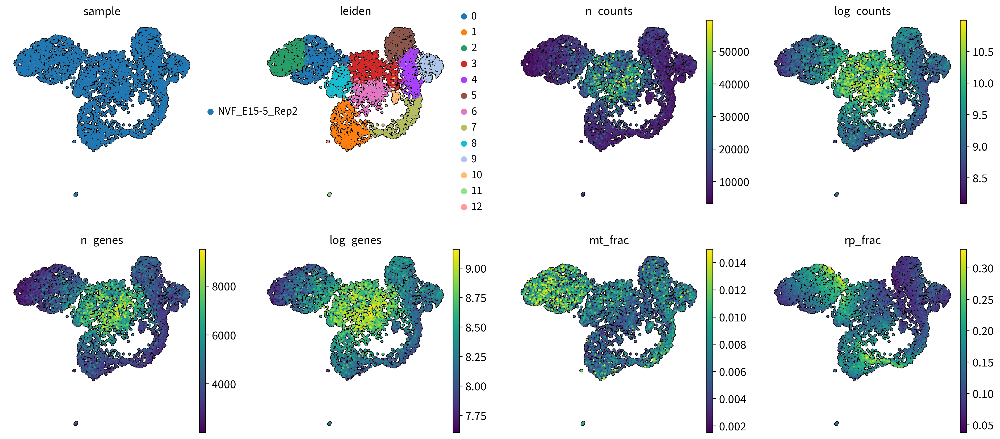

In [14]:
sc.pl.umap(adata, color=['sample','leiden','n_counts','log_counts','n_genes','log_genes','mt_frac','rp_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

# Doublet Identification GEX

## Scrublet

Running Scrublet
filtered out 9773 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:00)
Embedding transcriptomes using PCA...
Detected doublet rate = 25.5%
Estimated detectable doublet fraction = 79.3%
Overall doublet rate:
	Expected   = 12.0%
	Estimated  = 32.1%
    Scrublet finished (0:00:13)


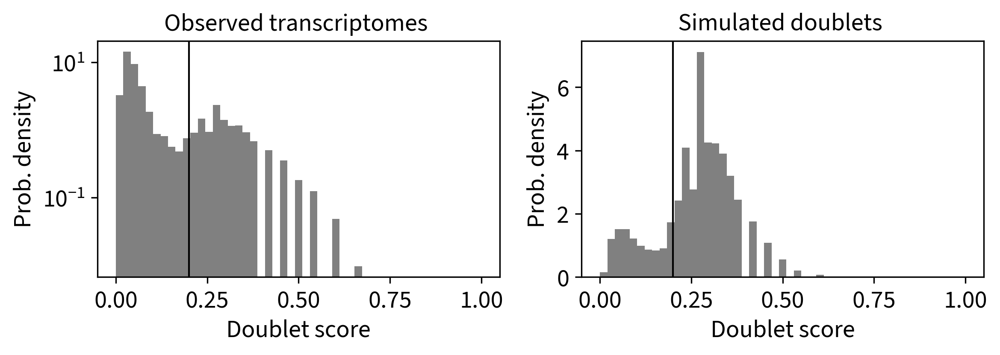

In [22]:
sce.pp.scrublet(adata, sim_doublet_ratio=5, expected_doublet_rate=0.12, threshold=0.2)
sce.pl.scrublet_score_distribution(adata)

In [23]:
adata.obs['scrublet_doublets_cat'] = adata.obs['predicted_doublet'].astype(str).astype('category')

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

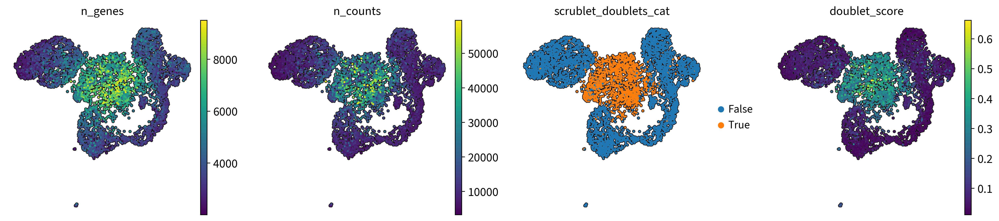

In [24]:
sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_doublets_cat','doublet_score'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

## SCDS

In [18]:
run_SCDS(adata)

Finding doublets with scDblFinder:
[1] "Cores: 64"
[1] "Memory: 128"

    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    	Transfer data...
	Doublet Detection with standard normalization...
		Preprocessing...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


		Running SCDS...
		Collect results...
	Doublet Detection with SCT normalization...
		Preprocessing...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


		Running SCDS...
		Collect results...
		Add results to anndata...


------------------------------------------------------------------------------------
------------------------------------------------------------------------------------

Scds doublet rate: 29.61440595028381 % ( 1513  cells)


In [19]:
print('Scds doublet rate:', (adata.obs['hybrid_class'] == 'doublet').value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_class'] == 'doublet').value_counts()[1],' cells)' )
print('Cut-off:', min(adata[adata.obs['hybrid_class'] == 'doublet'].obs['hybrid_score']))

Scds doublet rate: 28.90976707770601 % ( 1477  cells)
Cut-off: 0.5457947420150883


/tmp/ipykernel_981293/4255365708.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(adata.obs['hybrid_score'], kde=True, bins=100)
/tmp/ipykernel_981293/4255365708.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(adata.obs['hybrid_score'][(adata.obs['hybrid_score']>0.35) & (adata.obs['hybrid_s

Scds doublet rate: 15.443335290663535 % ( 789  cells)


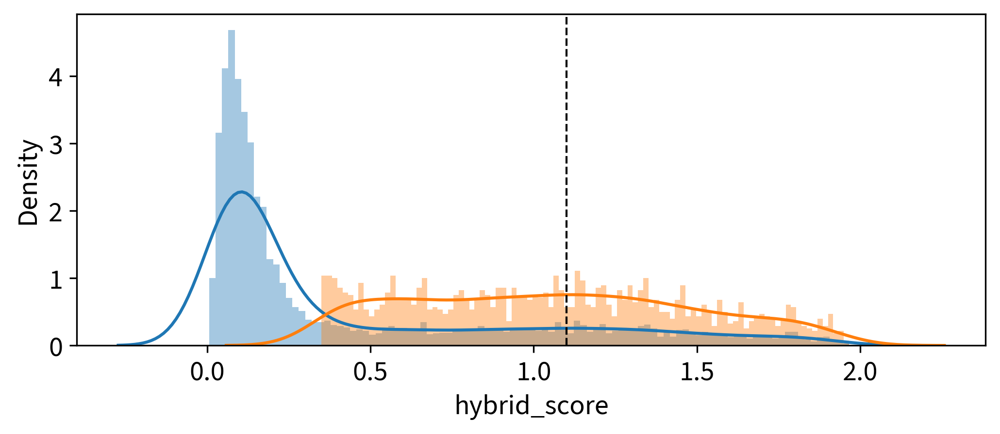

In [26]:
# Adjust cut-off as doublet rate is too high 
cut_off = 1.1 #min(adata[adata.obs['hybrid_class'] == 'doublet'].obs['hybrid_score'])

with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(adata.obs['hybrid_score'], kde=True, bins=100)
    sb.distplot(adata.obs['hybrid_score'][(adata.obs['hybrid_score']>0.35) & (adata.obs['hybrid_score']<2)], kde=True, bins=100)
    plt.axvline(cut_off, 0, 1, color="black", lw=1).set_linestyle("--")

print('Scds doublet rate:', (adata.obs['hybrid_score'] > cut_off).value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_score'] > cut_off).value_counts()[1],' cells)' )

In [27]:
adata.obs['hybrid_class'] = pd.Categorical(adata.obs['hybrid_class'], categories=['doublet','singlet'])
adata.obs['hybrid_class'] = 'singlet'
adata.obs.loc[adata.obs['hybrid_score'] > cut_off,'hybrid_class'] = 'doublet'

In [28]:
print('Scds doublet rate:', (adata.obs['hybrid_class_sct'] == 'doublet').value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_class_sct'] == 'doublet').value_counts()[1],' cells)' )
print('Cut-off:', min(adata[adata.obs['hybrid_class_sct'] == 'doublet'].obs['hybrid_score_sct']))

Scds doublet rate: 14.816989626149931 % ( 757  cells)
Cut-off: 0.5026383091594623


/tmp/ipykernel_981293/2250541397.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(adata.obs['hybrid_score_sct'], kde=True, bins=100)
/tmp/ipykernel_981293/2250541397.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(adata.obs['hybrid_score_sct'][(adata.obs['hybrid_score_sct']>0.35) & (adata.o

Scds doublet rate: 14.95400274026228 % ( 764  cells)


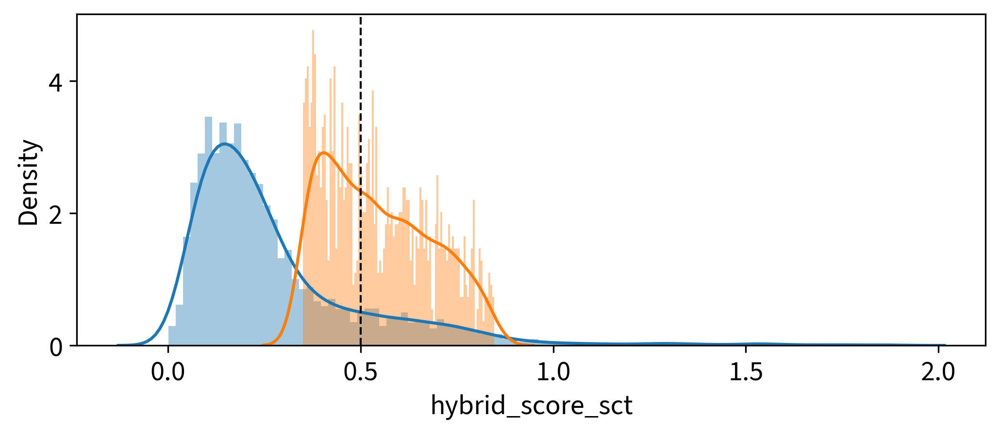

In [30]:
# Adjust cut-off as doublet rate is too high 
cut_off = 0.5 #min(adata[adata.obs['hybrid_class_sct'] == 'doublet'].obs['hybrid_score_sct'])

with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(adata.obs['hybrid_score_sct'], kde=True, bins=100)
    sb.distplot(adata.obs['hybrid_score_sct'][(adata.obs['hybrid_score_sct']>0.35) & (adata.obs['hybrid_score_sct']<0.85)], kde=True, bins=100)
    plt.axvline(cut_off, 0, 1, color="black", lw=1).set_linestyle("--")

print('Scds doublet rate:', (adata.obs['hybrid_score_sct'] > cut_off).value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_score_sct'] > cut_off).value_counts()[1],' cells)' )

In [31]:
adata.obs['hybrid_class_sct'] = pd.Categorical(adata.obs['hybrid_class_sct'], categories=['doublet','singlet'])
adata.obs['hybrid_class_sct'] = 'singlet'
adata.obs.loc[adata.obs['hybrid_score_sct'] > cut_off,'hybrid_class_sct'] = 'doublet'

In [32]:
adata.obs.loc[:,'scds_doublets'] = False
adata.obs.loc[adata.obs.loc[:,'hybrid_class']=='doublet','scds_doublets'] = True
adata.obs.loc[adata.obs.loc[:,'hybrid_class_sct']=='doublet','scds_doublets'] = True

print('Scds doublet rate:', adata.obs['scds_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['scds_doublets'].value_counts()[1],' cells)' )

Scds doublet rate: 19.72988843217851 % ( 1008  cells)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

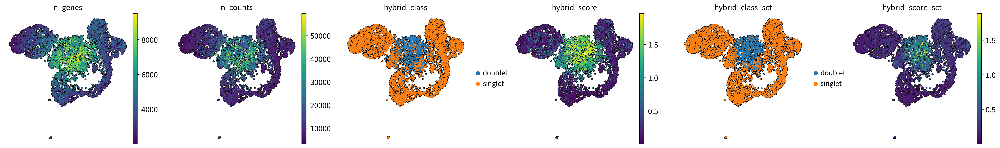

In [33]:
sc.pl.umap(adata, color=['n_genes','n_counts','hybrid_class','hybrid_score','hybrid_class_sct','hybrid_score_sct'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

## scDblFinder

In [34]:
run_scDblFinder(adata)

Finding doublets with scDblFinder:
[1] "Cores: 64"
[1] "Memory: 128"
	Transfer data...
		Found data matrix of same shape. Skipping data transfer...
	Doublet Detection with standard normalization...
		Preprocessing...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


		Running scDblFinder...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


		Collect results...
	Doublet Detection with SCT normalization...
		Preprocessing...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


		Running scDblFinder...
		Collect results...
		Add results to anndata...


------------------------------------------------------------------------------------
------------------------------------------------------------------------------------

scDblFinder doublet rate: 11.274221961244862 % ( 576  cells)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

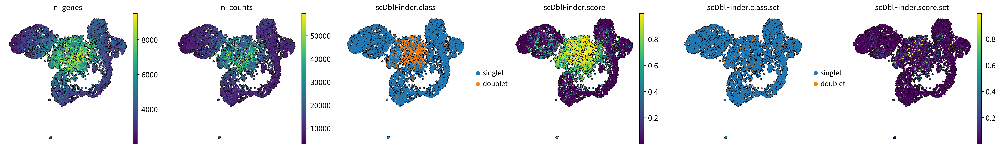

In [35]:
sc.pl.umap(adata, color=['n_genes','n_counts','scDblFinder.class','scDblFinder.score','scDblFinder.class.sct','scDblFinder.score.sct'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

## DoubletFinder

In [36]:
run_DoubletFinder(adata)

Finding doublets with scDblFinder:
[1] "Cores: 64"
[1] "Memory: 128"
	Transfer data...
		Found data matrix of same shape. Skipping data transfer...
	Doublet Detection with standard normalization...
		Preprocessing...
		Running DoubletFinder...


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


[1] "Creating 1703 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."
[1] "Finding variable genes..."
[1] "Scaling data..."
[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
		Collect results...
	Doublet Detection with SCT normalization...
		Preprocessing...
		Running DoubletFinder...


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


[1] "Creating 1703 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Running SCTransform..."
  |======================================================================| 100%
  |======================================================================| 100%
  |======================================================================| 100%
[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
		Collect results...
		Add results to anndata...


------------------------------------------------------------------------------------
------------------------------------------------------------------------------------

DoubletFinder doublet rate:  13.583871599138774 % ( 694  cells)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

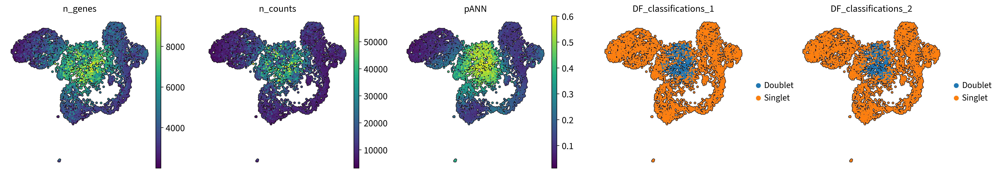

In [37]:
sc.pl.umap(adata, color=['n_genes','n_counts','pANN','DF_classifications_1','DF_classifications_2'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

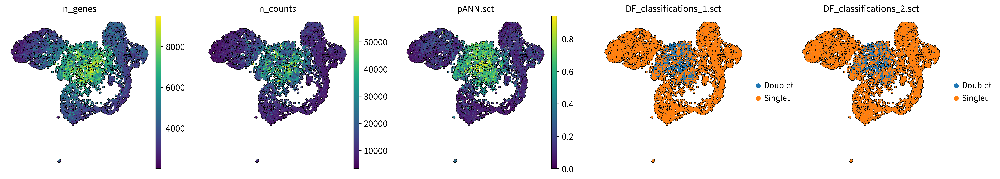

In [38]:
sc.pl.umap(adata, color=['n_genes','n_counts','pANN.sct','DF_classifications_1.sct','DF_classifications_2.sct'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

## Doublet Detection

In [39]:
adata.obs['dd_doublets']=0
adata.obs['dd_scores']=0
adata.obs['dd_log_p_values']=0
adata.obs['dd_voting_average']=0

In [40]:
adata_clf = doubletdetection.BoostClassifier(n_iters=200, clustering_algorithm='leiden', standard_scaling=True, n_jobs=64, random_state=123)
adata_dd_doublets = adata_clf.fit(adata.X).predict(p_thresh=1e-6, voter_thresh=0.8)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/doubletdetection/doubletdetection.py:116: UserWarning: Leiden clustering is experimental and results have not been validated.
  warnings.warn("Leiden clustering is experimental and results have not been validated.")


  0%|          | 0/200 [00:00<?, ?it/s]

computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 59 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['con

    finished: found 55 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 54 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finis

running Leiden clustering
    finished: found 54 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 59 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 56 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 58 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 56 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 60 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 56 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 59 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 56 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 58 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 53 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 58 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 59 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 52 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 57 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 55 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 54 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 57 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 57 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 57 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 57 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 61 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 59 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 54 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

running Leiden clustering
    finished: found 55 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 53 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=30
    finished (0:00:01)
computing neighbors
    using 'X_pca'

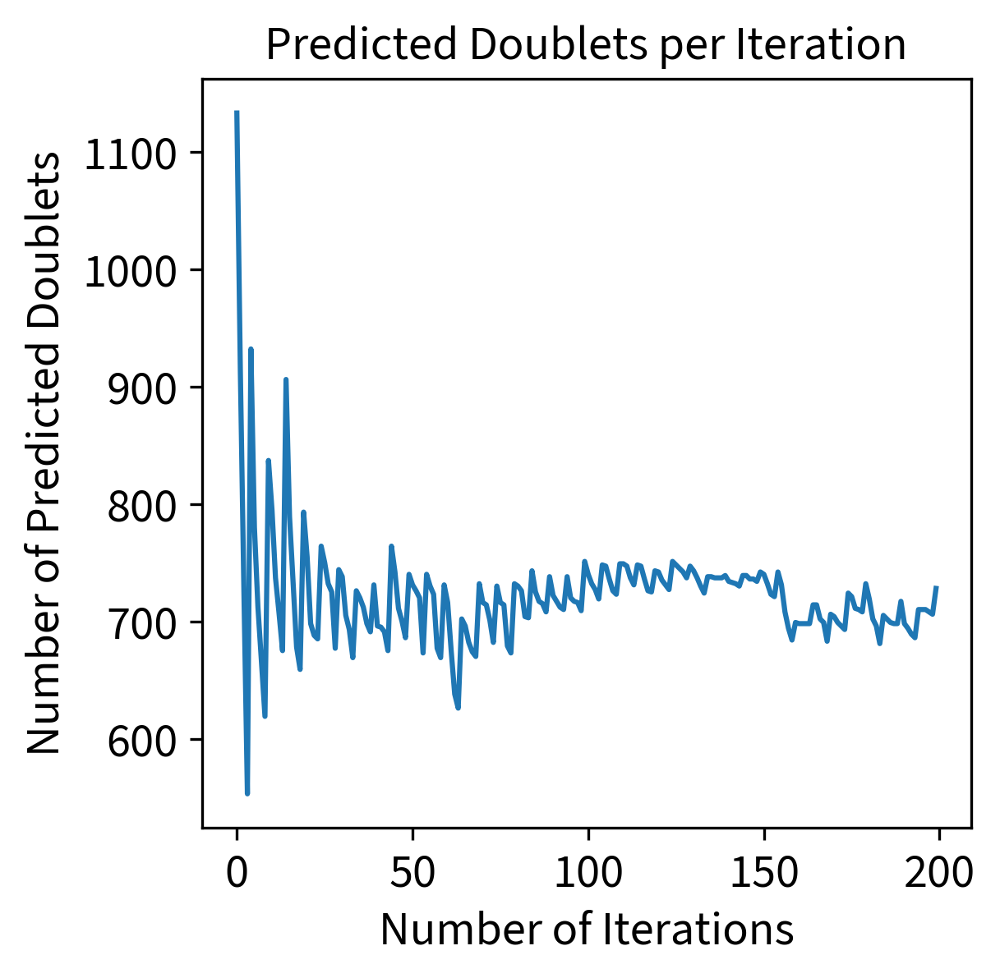

In [41]:
plot=doubletdetection.plot.convergence(adata_clf, show=False, p_thresh=1e-6, voter_thresh=0.8)

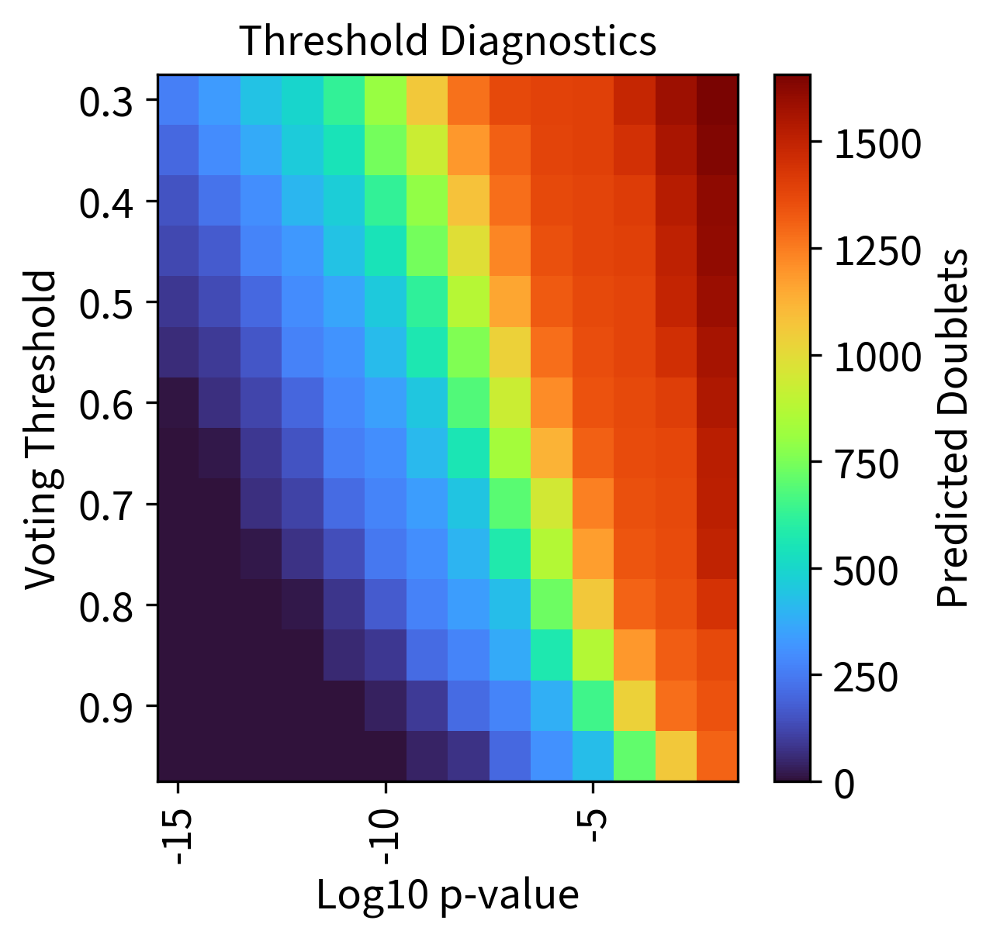

In [42]:
plot=threshold(adata_clf, show=True, p_step=5, log_p_grid=np.arange(-15, -1))

In [43]:
adata.obs['dd_doublets']=adata_dd_doublets.astype('bool')
adata.obs['dd_-log_p_values']=np.mean(adata_clf.all_log_p_values_, axis=0) * -1
adata.obs['dd_voting_average']=adata_clf.voting_average_
adata.obs['dd_scores']=np.mean(adata_clf.all_scores_, axis=0)

In [44]:
adata.obs['dd_doublets_cat'] = adata.obs['dd_doublets'].astype(str).astype('category')

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

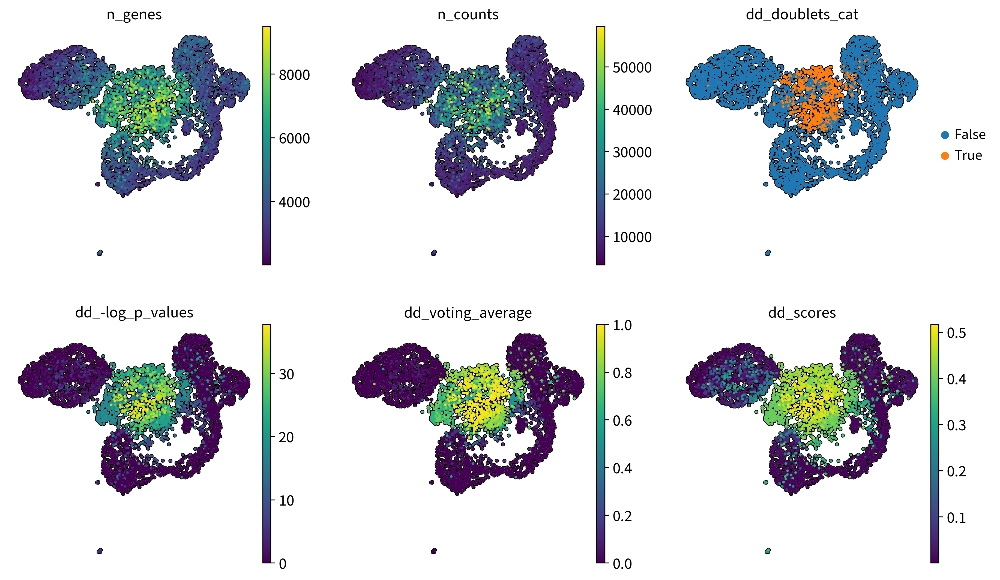

In [45]:
sc.pl.umap(adata, color=['n_genes','n_counts','dd_doublets_cat','dd_-log_p_values','dd_voting_average','dd_scores'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=3)

In [46]:
print('DoubletDetection doublet rate:', adata.obs['dd_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['dd_doublets'].value_counts()[1],' cells)' )

DoubletDetection doublet rate: 14.249363867684478 % ( 728  cells)


## Solo

In [47]:
scvi.model.SCVI.setup_anndata(adata)
vae = scvi.model.SCVI(adata, n_hidden=256, n_latent=20, gene_likelihood='nb')
vae.train()
solo = scvi.external.SOLO.from_scvi_model(vae)
solo.train()
predictions = solo.predict()
predictions['solo_doublet_class'] = solo.predict(soft=False)

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██| 400/400 [02:41<00:00,  2.46it/s, loss=1.08e+04, v_num=1]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██| 400/400 [02:41<00:00,  2.48it/s, loss=1.08e+04, v_num=1]
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are 

Epoch 119/400:  30%|█▍   | 119/400 [00:27<01:05,  4.29it/s, loss=0.304, v_num=1]
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.291. Signaling Trainer to stop.


In [48]:
predictions.index = [index[:-2] for index in predictions.index]
predictions.columns = ['solo_doublet_score', 'solo_singlet_score','solo_doublet_class']

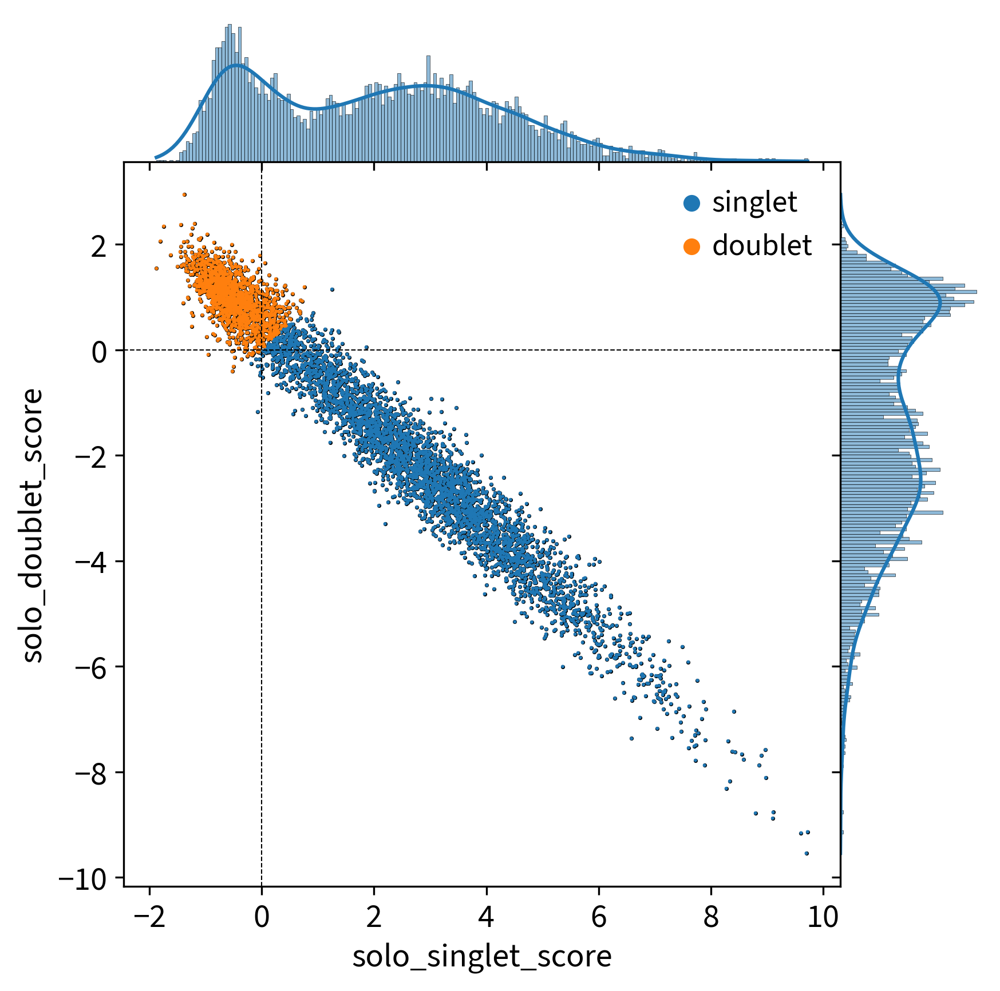

In [49]:
p=sb.jointplot(data=predictions, x='solo_singlet_score', y='solo_doublet_score', s=2, kind='scatter', linewidth=0, space=0, marginal_kws=dict(bins=200, kde=True)) #, hue='solo_doublet_class',data=predictions))
p.plot_joint(sb.scatterplot, color="black", s=3 ,data=predictions, linewidth=0)
p.plot_joint(sb.scatterplot, s=2, hue='solo_doublet_class',data=predictions, linewidth=0)
p.ax_joint.axvline(x=0, ymin=0, ymax=max(predictions['solo_doublet_score']), color="black", lw=0.5).set_linestyle("--")
p.ax_joint.axhline(y=0, xmin=0, xmax=max(predictions['solo_singlet_score']), color="black", lw=0.5).set_linestyle("--")
p.ax_joint.legend(frameon=False)
plt.show()

In [50]:
print('SOLO doublet rate:', sum(predictions.solo_doublet_class == 'doublet')/adata.n_obs*100, '% (',sum(predictions.solo_doublet_class == 'doublet'),' cells)' )

SOLO doublet rate: 29.027206889802308 % ( 1483  cells)


In [51]:
adata.obs = pd.concat([adata.obs, predictions], axis=1)
adata.obs['solo_doublets'] = False
adata.obs.loc[adata.obs['solo_doublet_class'] == 'doublet','solo_doublets'] = True

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: 

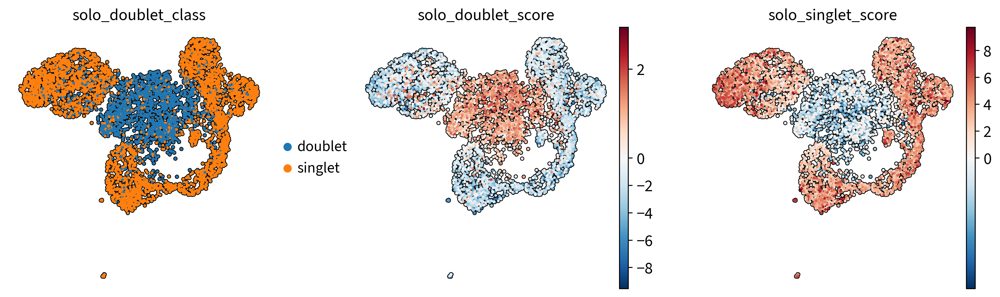

In [52]:
sc.pl.umap(adata, color=['solo_doublet_class','solo_doublet_score', 'solo_singlet_score'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=3, cmap='RdBu_r', vcenter=0)

# Doublet Identification ATAC

## AMULET & scDblFinder



In [53]:
atac = mdata.mod['atac']

In [54]:
run_scDblFinder_ATAC(atac, repeats_file='/mnt/ssd/Genomes/mm10/Repeats/AMULET_Exclusion_List_Regions/AMULET_exclusion_regions_noChr.bed')

Finding scATAC-seq doublets with scDblFinder:
[1] "Cores: 64"
[1] "Memory: 128"
	Transfer data...


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata2ri/r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


	Running scDblFinder...
[1] "\t\tscDblFinder finished with 25 features..."
	Running AMULET...
	Collect results...
	Add results to anndata...


/tmp/ipykernel_981293/3366139497.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['atac.combined.score'], kde=True, bins=100)


<Axes: xlabel='atac.combined.score', ylabel='Density'>

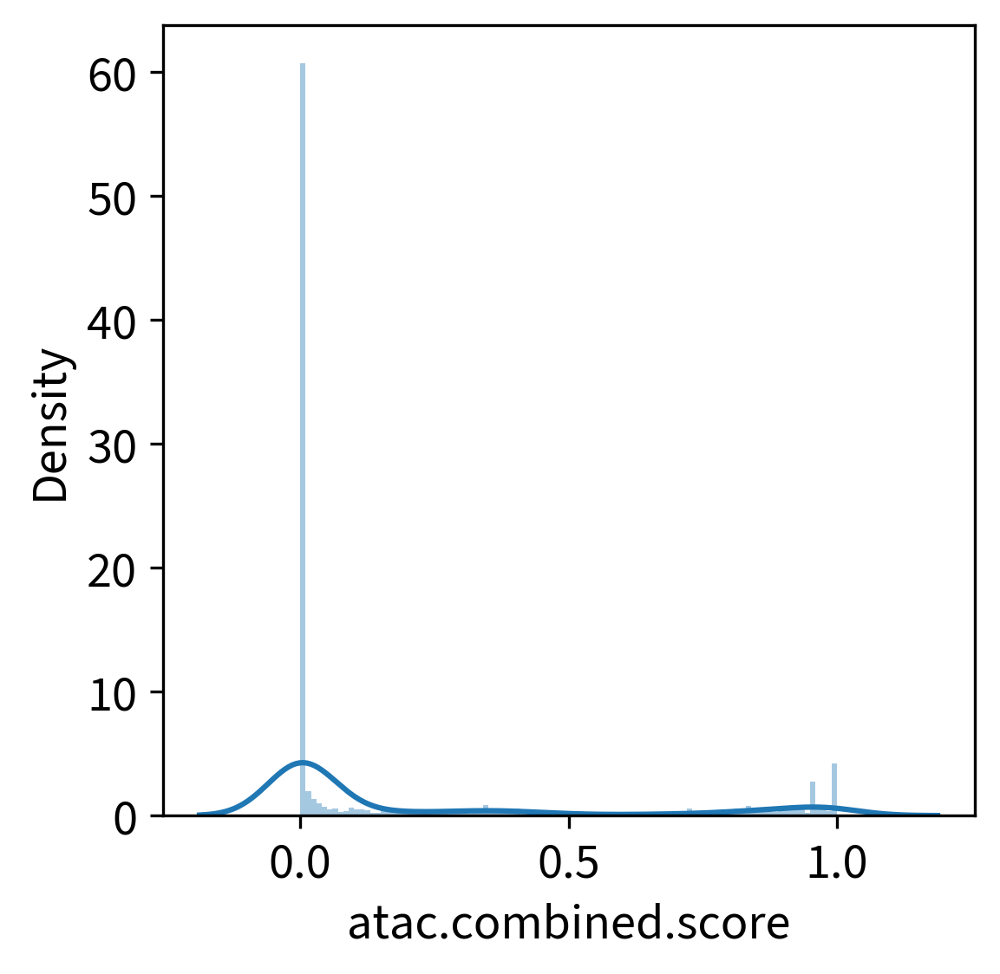

In [55]:
sb.distplot(atac.obs['atac.combined.score'], kde=True, bins=100)

/tmp/ipykernel_981293/2905939986.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['atac.combined.score'][(atac.obs['atac.combined.score']>0.95) & (atac.obs['atac.combined.score']<=1)], kde=True, bins=100)


ATAC doublet rate: 8.279506752789196 % ( 423  cells)


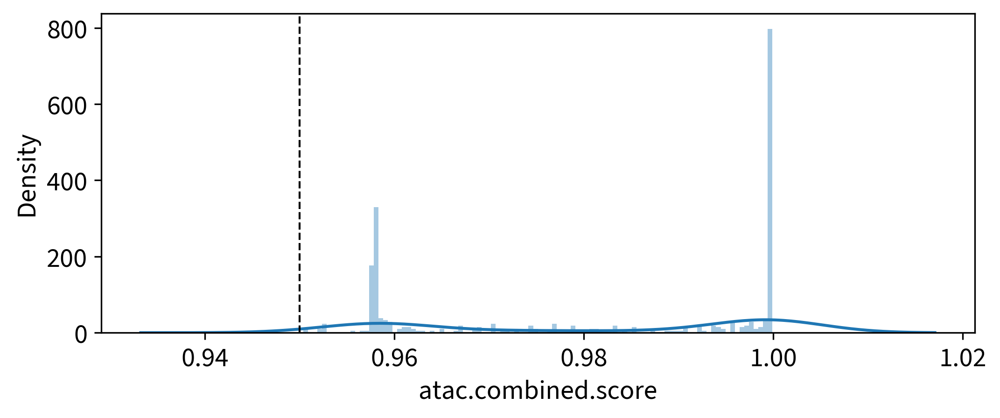

In [56]:
# Adjust cut-off as doublet rate is too high 
cut_off = 0.95 #min(atac[atac.obs['hybrid_class'] == 'doublet'].obs['atac.combined.score'])

with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['atac.combined.score'][(atac.obs['atac.combined.score']>0.95) & (atac.obs['atac.combined.score']<=1)], kde=True, bins=100)
    plt.axvline(cut_off, 0, 1, color="black", lw=1).set_linestyle("--")

print('ATAC doublet rate:', (atac.obs['atac.combined.score'] > cut_off).value_counts()[1]/atac.obs['sample'].value_counts()[0]*100, '% (',(atac.obs['atac.combined.score'] > cut_off).value_counts()[1],' cells)' )

In [57]:
atac.obs['atac.combined.class'] = 'singlet'
atac.obs['atac.combined.class'] = pd.Categorical(atac.obs['atac.combined.class'], categories=['doublet','singlet'])
atac.obs.loc[atac.obs['atac.combined.score'] >= cut_off,'atac.combined.class'] = 'doublet'

In [58]:
atac.obs.loc[:,'atac_sdf_doublets'] = False
atac.obs.loc[atac.obs.loc[:,'atac.combined.class']=='doublet','atac_sdf_doublets'] = True

print('ATAC AMULTET & scDblFinder doublet rate:', atac.obs['atac_sdf_doublets'].value_counts()[1]/atac.obs['sample'].value_counts()[0]*100, '% (',atac.obs['atac_sdf_doublets'].value_counts()[1],' cells)' )

ATAC AMULTET & scDblFinder doublet rate: 8.279506752789196 % ( 423  cells)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarn

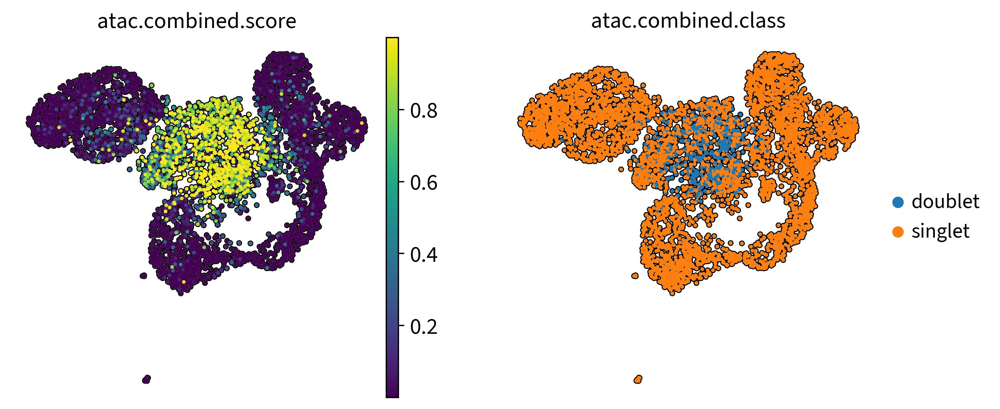

In [59]:
sc.pl.umap(atac, color=['atac.combined.score','atac.combined.class'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=3)

# Aggregate Doublet Calls

In [60]:
adata.obs['atac_sdf_doublets'] = atac.obs['atac_sdf_doublets'].copy()
mdata.obs['atac_sdf_doublets'] = atac.obs['atac_sdf_doublets'].copy()

mdata.obs[['predicted_doublet','dd_doublets','solo_doublets','df_doublets','sdf_doublets','scds_doublets']] = adata.obs[['predicted_doublet','dd_doublets','solo_doublets','df_doublets','sdf_doublets','scds_doublets']].copy()
atac.obs[['predicted_doublet','dd_doublets','solo_doublets','df_doublets','sdf_doublets','scds_doublets']] = adata.obs[['predicted_doublet','dd_doublets','solo_doublets','df_doublets','sdf_doublets','scds_doublets']].copy()

In [61]:
# Sum up doublets from different tools
mdata.obs['doublet_calls'] = mdata.obs[['predicted_doublet','dd_doublets','solo_doublets','df_doublets','sdf_doublets','scds_doublets','atac_sdf_doublets']].sum(axis=1)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: 

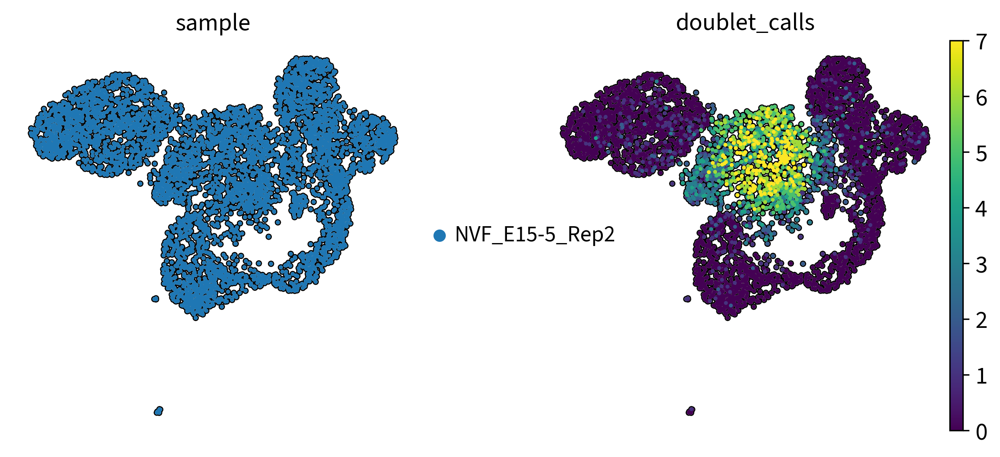

In [62]:
sc.pl.umap(mdata, color=['sample','doublet_calls'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

In [63]:
# Number of calls
print(mdata.obs['doublet_calls'].value_counts())

0    3383
1     367
2     261
3     246
4     233
5     233
6     212
7     174
Name: doublet_calls, dtype: int64


In [64]:
mdata.obs.loc[:,'final_doublets'] = False
mdata.obs.loc[mdata.obs.loc[:,'doublet_calls'] > 3,'final_doublets'] = True

In [65]:
mdata.obs['final_doublets_cat'] = mdata.obs['final_doublets'].astype(str).astype('category')

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: 

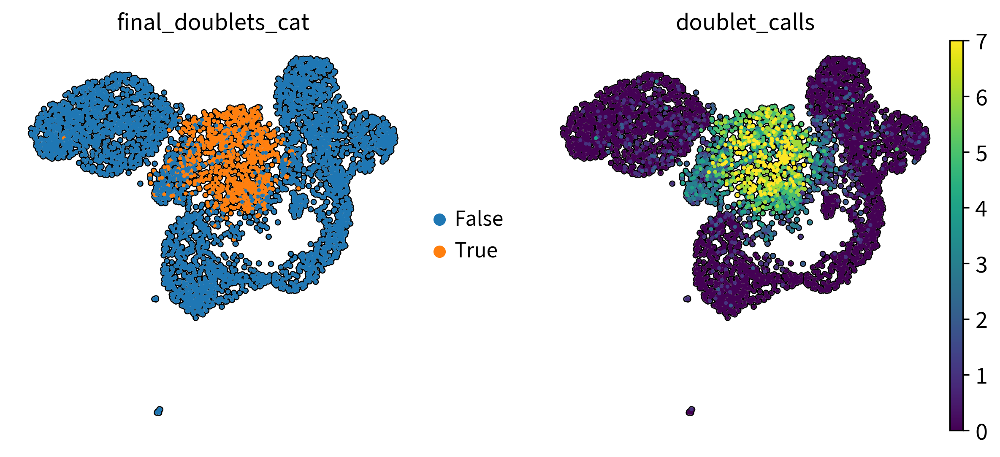

In [66]:
sc.pl.umap(mdata, color=['final_doublets_cat','doublet_calls'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

In [67]:
# Number of final doublets
print('Number of doublets:')
print(mdata.obs['final_doublets'].value_counts())

# Percentage:
print('\nOverall doublet rate: ',mdata.obs['final_doublets'].value_counts()[1]/len(mdata.obs['final_doublets'])*100,'%')

Number of doublets:
False    4257
True      852
Name: final_doublets, dtype: int64

Overall doublet rate:  16.676453317674692 %


In [68]:
# Annotate the data sets
print(mdata.obs['sample'].value_counts())

# Checking the total size of the data set
mdata.shape

NVF_E15-5_Rep2    5109
Name: sample, dtype: int64


(5109, 223466)

In [69]:
adata.obs[['final_doublets','final_doublets_cat','doublet_calls']] = mdata.obs[['final_doublets','final_doublets_cat','doublet_calls']].copy()
atac.obs[['final_doublets','final_doublets_cat','doublet_calls']] = mdata.obs[['final_doublets','final_doublets_cat','doublet_calls']].copy()

# Save

In [70]:
# Save
mdata.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E15-5_Rep2/outs/NVF_E15-5_Rep2_raw_feature_bc_matrix_filtered_markedDoublets.h5mu')

# Session Info

In [71]:
%%R
sessionInfo()

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Ubuntu 20.04.6 LTS

Matrix products: default
BLAS/LAPACK: /home/michi/Software/venvs/scverse_2023_test/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
 [1] parallel  stats4    tools     stats     graphics  grDevices utils    
 [8] datasets  methods   base     

other attached packages:
 [1] ROCR_1.0-11                 KernSmooth_2.23-20         
 [3] fields_15.2                 viridisLite_0.4.2          
 [5] spam_2.9-1                  DoubletFinder_2.0.3        
 [7] scDblFinder_1.12.0          Matrix_1.5-3               
 [9] doParallel

In [72]:
sc.logging.print_versions()

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                         9.4.0
absl                        NA
anndata2ri                  1.1
annoy                       NA
asttokens                   NA
attr                        22.2.0
backcall                    0.2.0
backports                   NA
certifi                     2022.12.07
cffi                        1.15.1
charset_normalizer          3.1.0
chex                        0.1.6
comm                        0.1.2
contextlib2                 NA
cycler                      0.10.0
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.6.6
decorator                   5.1.1
defusedxml                  0.7.1
docrep                      0.3.2
doubletdetection            4.2
etils                       1.0.0
executing                   1.2.0
flax                        0.6.6
fsspec                      2023.3.0
h5py                        3.8.0
idna                        3.4
igraph       